In [4]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal
import soundfile as sf

In [7]:
data, fe = sf.read("NR4.wav")

RuntimeError: Error opening 'NR4.wav': System error.

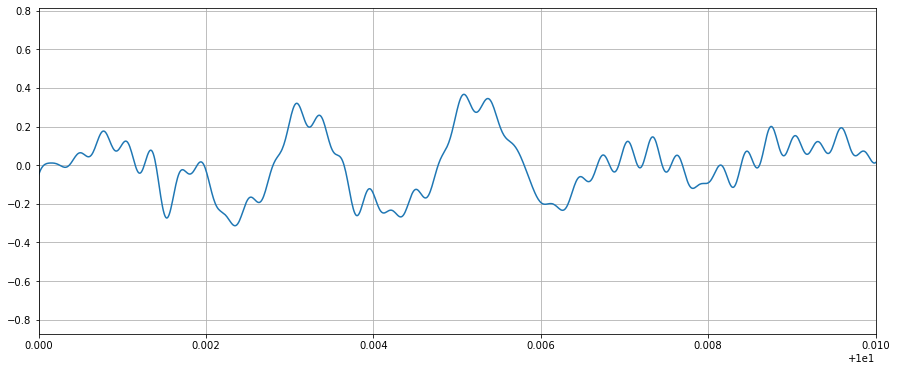

In [198]:
t = np.arange(10, 12, 1/fe)
intervalle = data[10*fe:12*fe]

fig, ax = plt.subplots(figsize = (15, 6))
ax.set_xlim([10, 10.01])
ax.plot(t,intervalle)
ax.grid()

#Affichage de la figure
plt.show()

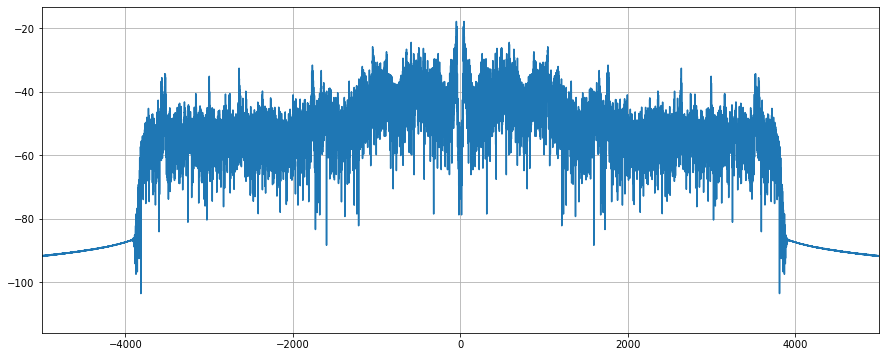

In [199]:
te = 1/fe
N=len(intervalle)
tfft=N*te
F = np.arange(-fe/2,fe/2,fe/N)


#FFT bilaterale du signal s. Avec le tfft/N on obtient, si on prend le module, la densité
#(répartition) spectrale (en fonction de la fréquence) de tension en Volt/Hz avec les mêmes
#valeurs que la transformée de Fourier
sin = tfft/N*np.fft.fftshift(np.fft.fft(intervalle))
#Module de S. On a alors la densité spectrale de tension en Volt/Hz
sin_mag = np.abs(sin)
#Densité spectrale de tension en Volt efficace/Hz
sin_eff=sin_mag/np.sqrt(2)
#Densité spectrale de puissance en dBm/Hz
sin_dBm=10*np.log10(np.square(sin_eff)/50*1000)

fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(F,sin_dBm)
ax.set_xlim([-5000,5000])
ax.grid()

In [201]:
!sox --i "NR4_SAE.wav"


Input File     : 'NR4_SAE.wav'
Channels       : 1
Sample Rate    : 100000
Precision      : 16-bit
Duration       : 00:00:40.00 = 4000000 samples ~ 3000 CDDA sectors
File Size      : 8.00M
Bit Rate       : 1.60M
Sample Encoding: 16-bit Signed Integer PCM



In [202]:
t = np.arange(10, 12, 1/fe)
f_zero = 10000
intervalle_D=intervalle*(np.cos(2*np.pi*f_zero*t))

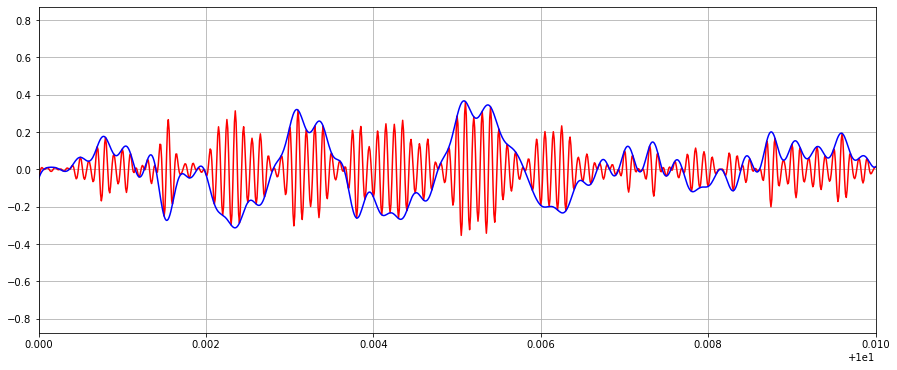

In [203]:
t = np.arange(10, 12, 1/fe)

fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(t,intervalle_D, color = 'r')
ax.set_xlim([10, 10.01])
ax.plot(t, intervalle, color = 'b')
ax.grid()
#Affichage de la figure
plt.show()

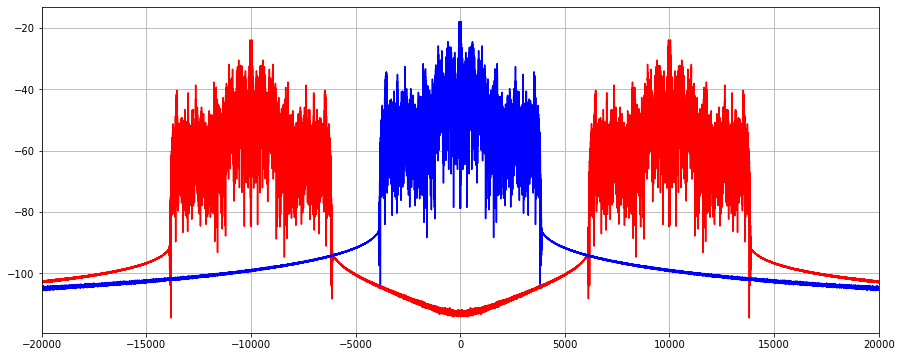

In [204]:
te = 1/fe
N=len(intervalle_D)
tfft=N*te
F = np.arange(-fe/2,fe/2,fe/N)


#FFT bilaterale du signal s. Avec le tfft/N on obtient, si on prend le module, la densité
#(répartition) spectrale (en fonction de la fréquence) de tension en Volt/Hz avec les mêmes
#valeurs que la transformée de Fourier
SINUSOIDAL = tfft/N*np.fft.fftshift(np.fft.fft(intervalle_D))
#Module de S. On a alors la densité spectrale de tension en Volt/Hz
SINUSOIDAL_mag = np.abs(SINUSOIDAL)
#Densité spectrale de tension en Volt efficace/Hz
SINUSOIDAL_eff=SINUSOIDAL_mag/np.sqrt(2)
#Densité spectrale de puissance en dBm/Hz
SINUSOIDAL_dBm=10*np.log10(np.square(SINUSOIDAL_eff)/50*1000)

fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(F,SINUSOIDAL_dBm, color='r')
ax.plot(F,sin_dBm, color='b')
ax.set_xlim([-20000,20000])
ax.grid()

Signal Modulé = Signal(t) * cos(2*pi*f0*t)

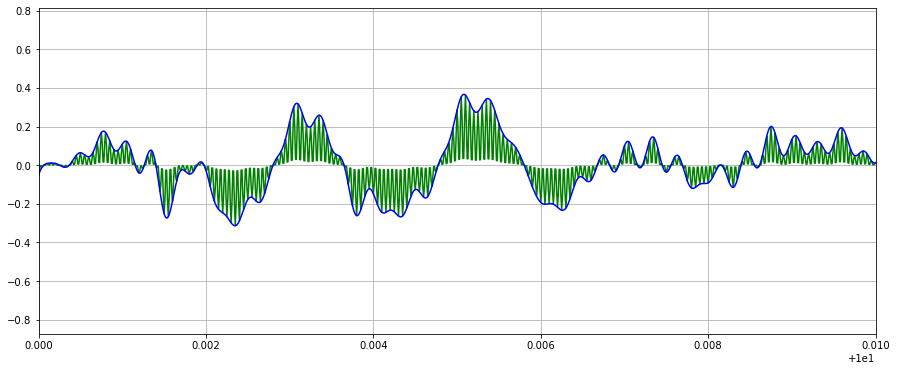

In [205]:
intervalle_DD = intervalle_D*(np.cos(2*np.pi*f_zero*t))
t = np.arange(10, 12, 1/fe)

fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(t,intervalle_DD, color = 'g')
ax.set_xlim([10, 10.01])
ax.plot(t, intervalle, color = 'b')
ax.grid()
#Affichage de la figure
plt.show()

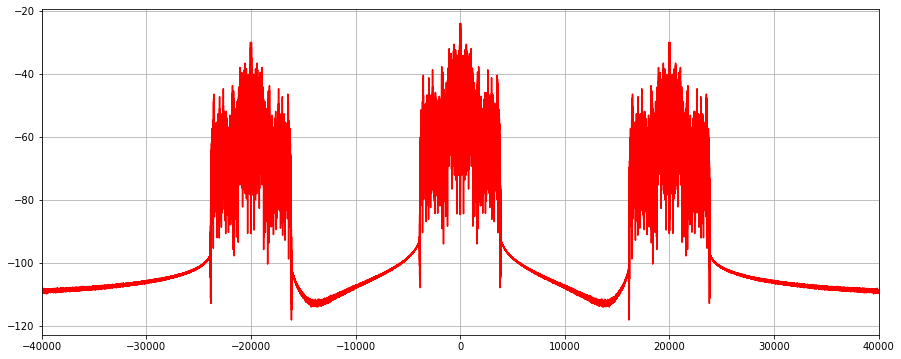

In [206]:
te = 1/fe
N=len(intervalle_DD)
tfft=N*te
F = np.arange(-fe/2,fe/2,fe/N)


#FFT bilaterale du signal s. Avec le tfft/N on obtient, si on prend le module, la densité
#(répartition) spectrale (en fonction de la fréquence) de tension en Volt/Hz avec les mêmes
#valeurs que la transformée de Fourier
SINUSDD = tfft/N*np.fft.fftshift(np.fft.fft(intervalle_DD))
#Module de S. On a alors la densité spectrale de tension en Volt/Hz
SINUSDD_mag = np.abs(SINUSDD)
#Densité spectrale de tension en Volt efficace/Hz
SINUSDD_eff=SINUSDD_mag/np.sqrt(2)
#Densité spectrale de puissance en dBm/Hz
SINUSDD_dBm=10*np.log10(np.square(SINUSDD_eff)/50*1000)
fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(F,SINUSDD_dBm, color='r')
ax.set_xlim([-40000,40000])
ax.grid()

In [211]:
nyquist = fe * 0.5
fc = 5000
fcn = fc/nyquist
order = 8
b, a = scipy.signal.butter(order, fcn, btype ='low', analog=False)
filtered = scipy.signal.lfilter(b, a, intervalle_DD)

In [5]:
t = np.arange(10, 12, 1/fe)

fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(t,filtered, color = 'g')
ax.set_xlim([10, 10.01])
ax.plot(t, 1/2*intervalle, color = 'b')
ax.grid()
#Affichage de la figure
plt.show()

NameError: name 'fe' is not defined

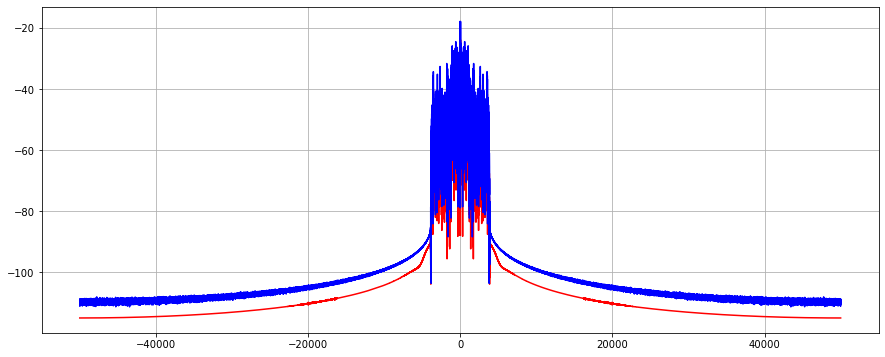

In [214]:
te = 1/fe
N=len(filtered)
tfft=N*te
F = np.arange(-fe/2,fe/2,fe/N)


#FFT bilaterale du signal s. Avec le tfft/N on obtient, si on prend le module, la densité
#(répartition) spectrale (en fonction de la fréquence) de tension en Volt/Hz avec les mêmes
#valeurs que la transformée de Fourier
SINUSF = tfft/N*np.fft.fftshift(np.fft.fft(filtered))
#Module de S. On a alors la densité spectrale de tension en Volt/Hz
SINUSF_mag = np.abs(SINUSF)
#Densité spectrale de tension en Volt efficace/Hz
SINUSF_eff=SINUSF_mag/np.sqrt(2)
#Densité spectrale de puissance en dBm/Hz
SINUSF_dBm=10*np.log10(np.square(SINUSF_eff)/50*1000)
fig, ax = plt.subplots(figsize = (15, 6))
ax.plot(F,SINUSF_dBm, color='r')
ax.plot(F,sin_dBm, color='b')
#ax.set_xlim([-10000,10000])
ax.grid()

PENSER A AJOUTER CAPTURE DIFFERENTS ORDRES

In [212]:
filtered_G = scipy.signal.lfilter(b, a, data)
sf.write("NR4_filtré.wav", filtered_G, fe)

In [185]:
import IPython.display as ipd

In [213]:
ipd.Audio("NR4_filtré.wav") 


In [208]:
ipd.Audio("NR4_SAE.wav")

On refait le même processus pour une démodulation avec 10000,1 Hz de fréquence

In [231]:
f_zeromod = 10000
f_zero_Demod = 10000.1
t = np.arange(0, 15, 1/fe)

In [233]:
Mod_signal = data * np.cos(2*np.pi*f_zeromod*t)

ValueError: operands could not be broadcast together with shapes (4000000,) (1500000,) 